## Simulate read counts of an idealized scGRO-seq dataset for mm10 genes

In [1]:
.libPaths("/home/mahat/.conda/envs/r422/lib/R/library")
.libPaths()

[1] "/net/bmc-lab2/data/lab/sharp/mahat/conda/envs/r422/lib/R/library"

In [2]:
suppressMessages({
    library(tidyverse)
    library(matrixStats)
    library(Seurat)
    library(BiocParallel)
    library(foreach)
    library(doParallel)
    library(plyranges)
    library(viridis)
    library(ggpointdensity)
});

In [3]:
options(
    repr.plot.width=4,
    repr.plot.height=4,
    jupyter.plot_mimetypes = "image/svg+xml"
);
theme_set(theme_classic() +
    theme(
        axis.title.x = element_text(color="black", size=14, face="bold"), 
        axis.title.y = element_text(color="black", size=14, face="bold"),
        axis.text = element_text(color="black", size=12, face="bold"),
        plot.title = element_text(face="bold", size=14, hjust = 0.5),
        axis.line = element_blank(),
        # axis.ticks = element_blank()
        panel.border = element_rect(colour = "grey", fill=NA, linewidth=1)
    )
);

In [26]:
# Get equation and r^2 as string
# https://groups.google.com/forum/#!topic/ggplot2/1TgH-kG5XMA

lm_eqn = function(x, y) {
    m = lm(y ~ x);
    eq = substitute(italic(y) == a + b %.% italic(x)*","~~italic(r)^2~"="~r2, 
         list(a = format(unname(coef(m)[1]), digits = 2),
              b = format(unname(coef(m)[2]), digits = 2),
             r2 = format(summary(m)$r.squared, digits = 2)))
    as.character(as.expression(eq));
}

### Set simulation parameters

In [5]:
Ncells = 2642; # N cells

mean_reads = 300; # reads per cell
  sd_reads = 100; #

# mean and sd across genes
mean_burst_size = 2; # pol2 per burst
  sd_burst_size = 3; #
mean_burst_rate = 1; # bursts per hour
  sd_burst_rate = 1; # 

# deviation of burst size between cells for all genes
sd_cell_burst = 0.5;

pol2_speed     = 2500; # speed of RNA Pol2 in bp / min
trimEndLength = 1000;
maxLen = 10000; # max feature length allowed

In [6]:
# use real feature lengths
features = read_bed("../data/dREG_refinedFeatures_mES_mm10_OSNcustomEnhancers_SEs.bed");
features$score = NULL;

# truncate long features
longf = which( width(features) >= maxLen+trimEndLength );
features[longf] = features[longf] 

features = features %>%
    filter( width >= maxLen+trimEndLength ) %>%
    filter( substr(name, 0, 2) == "GN" ) %>%
    anchor_center() %>%
    mutate(width = width - trimEndLength) %>%
    resize( width = maxLen, fix="start" );
Nfeat = length(features);

In [8]:
summary(width(features))

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  10000   10000   10000   10000   10000   10000 

### Generate "ground truth" burst parameters (size and rate)

In [7]:
# generate burst parameters for each feature
features = features %>%
    mutate( B.SIZE = rnorm( Nfeat, mean_burst_size, sd_burst_size ) ) %>%
    mutate( B.RATE = rnorm( Nfeat, mean_burst_rate, sd_burst_rate ) ) %>%
    mutate( B.SIZE = ifelse( B.SIZE<1, 1, B.SIZE ) ) %>%
    mutate( B.RATE = ifelse( B.RATE<0.1, 0.1, B.RATE ) );

features

GRanges object with 13564 ranges and 3 metadata columns:
          seqnames            ranges strand |            name    B.SIZE
             <Rle>         <IRanges>  <Rle> |     <character> <numeric>
      [1]     chr1   4808059-4818058      + |       GN-Lypla1   1.61373
      [2]     chr1   4858193-4868192      + |        GN-Tcea1   4.12901
      [3]     chr1   5083477-5093476      + |      GN-Atp6v1h   2.63432
      [4]     chr1   5588949-5598948      + |        GN-Oprk1   1.00000
      [5]     chr1   6215161-6225160      + |       GN-Rb1cc1   6.99687
      ...      ...               ...    ... .             ...       ...
  [13560]     chrY 65057864-65067863      - | GN-LOC108168595   5.67551
  [13561]     chrY 67620969-67630968      - | GN-LOC108168524   7.84609
  [13562]     chrY 68282980-68292979      - | GN-LOC108168525   4.73429
  [13563]     chrY 72235199-72245198      - | GN-LOC108168530   4.18571
  [13564]     chrY 89735051-89745050      - |      GN-Gm21996   8.09137
       

In [9]:
# compute time window covered by each gene
gene_time = width(features) / pol2_speed;

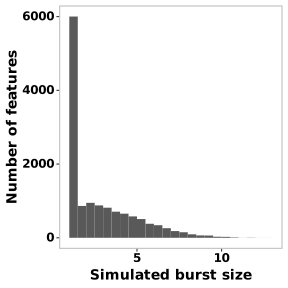

In [10]:
# plot histogram of true burst sizes
as.data.frame(features) %>%
    ggplot( aes(x=B.SIZE)  ) +
    geom_histogram(binwidth=0.5, boundary=0) +
    xlab("Simulated burst size") +
    ylab("Number of features");

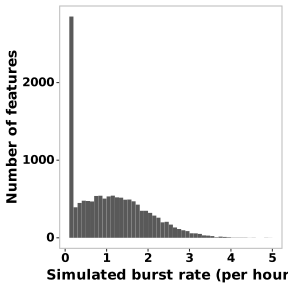

In [11]:
# plot histogram of true burst rates
as.data.frame(features) %>%
    ggplot( aes(x=B.RATE)  ) +
    geom_histogram(binwidth=0.1, boundary=0) +
    xlab("Simulated burst rate (per hour)") +
    ylab("Number of features");

### Simulate molecules and reads
Molecules are simulated directly from burst rate and size.
Reads are simulated by randomly sampling molecules.

In [12]:
# returns molecule counts in list[[1]]
# returns read counts in list[[2]]
simulate_reads = function( features, reads_per_cell ) {
    # compute amount of time visible on each gene
    # time will be in minutes from how pol2_speed is defined
    # (bp) / (bp / min) => min
    ncell = length(reads_per_cell);
    nfeat = length(features);
    
    # sample burst counts from poisson distribution
    molecules = rpois(
        n = ncell*nfeat,
        lambda = features$B.RATE*gene_time/60
    );
    
    # simulate burst size for this cell
    bsize = rnorm(
        n = ncell*nfeat,
        mean = features$B.SIZE,
        sd   = sd_cell_burst
    );
    bsize = ifelse( bsize < 1, 1, bsize );
    molecules = as.integer(molecules * bsize);
    molecules = matrix( as.numeric(molecules), nrow = nfeat, ncol=ncell);

    # label columns as cells, rows as features
    colnames(molecules) = paste0("cell", 1:ncell);
    rownames(molecules) = features$name;

    # randomly sample read counts
    reads = foreach( i = 1:ncell, .combine = "cbind" ) %dopar% {
        ftprobs  = molecules[,i] / sum(molecules[,i]);
        ftcounts = sample( 1:nfeat, size=reads_per_cell[i], replace=T, prob=ftprobs );
        ftcounts = as.data.frame(table(ftcounts), stringsAsFactors=F);
        out = rep(0, nfeat);
        out[as.integer(ftcounts[,1])] = ftcounts$Freq;
        return( out );
    }
    
    colnames(reads) = paste0("cell", 1:ncell);
    rownames(reads) = features$name;

    return(list(molecules, reads));
}

In [13]:
# generate random reads per cell to be sampled
rpc = as.integer(rnorm( Ncells, mean_reads, sd_reads  ));
rpc[rpc<200] = 200;
sim = simulate_reads( features, rpc );

Warning message:
“executing %dopar% sequentially: no parallel backend registered”


### Check simulation outputs

In [14]:
# molecules counts from this simulation
sim[[1]][1:9,1:9]

,cell1,cell2,cell3,cell4,cell5,cell6,cell7,cell8,cell9
GN-Lypla1,0,0,0,0,0,0,0,0,0
GN-Tcea1,0,0,0,0,0,0,0,0,0
GN-Atp6v1h,0,0,0,0,0,0,0,0,0
GN-Oprk1,0,0,0,0,0,0,0,0,0
GN-Rb1cc1,0,0,0,0,0,0,0,0,0
GN-Fam150a,0,2,0,0,0,0,0,0,0
GN-St18,0,0,0,0,0,0,0,0,0
GN-Pcmtd1,0,4,0,0,0,0,0,0,0
GN-Adhfe1,0,0,0,0,0,0,0,0,0


In [15]:
# read counts from this simulation
sim[[2]][1:9,1:9]

,cell1,cell2,cell3,cell4,cell5,cell6,cell7,cell8,cell9
GN-Lypla1,0,0,0,0,0,0,0,0,0
GN-Tcea1,0,0,0,0,0,0,0,0,0
GN-Atp6v1h,0,0,0,0,0,0,0,0,0
GN-Oprk1,0,0,0,0,0,0,0,0,0
GN-Rb1cc1,0,0,0,0,0,0,0,0,0
GN-Fam150a,0,0,0,0,0,0,0,0,0
GN-St18,0,0,0,0,0,0,0,0,0
GN-Pcmtd1,0,2,0,0,0,0,0,0,0
GN-Adhfe1,0,0,0,0,0,0,0,0,0


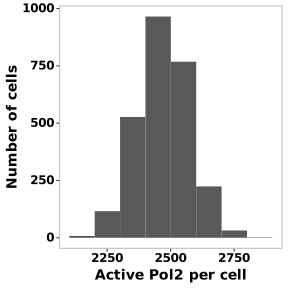

In [16]:
data.frame(RPC=colSums(sim[[1]])) %>%
    ggplot( aes(x=RPC)  ) +
    geom_histogram(binwidth=100, boundary=1) +
    xlab("Active Pol2 per cell") +
    ylab("Number of cells");

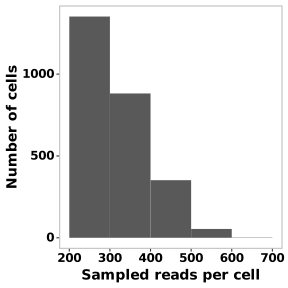

In [17]:
data.frame(RPC=colSums(sim[[2]])) %>%
    ggplot( aes(x=RPC) ) +
    geom_histogram(binwidth=100, boundary=0) +
    xlab("Sampled reads per cell") +
    ylab("Number of cells");

### Estimate kinetic parameters from simulation

In [18]:
estBurstSize = function(counts) {
    counts = counts[counts>0];
    return(mean(counts));
}

out = data.frame(eBSIZE=apply(sim[[1]], 1, estBurstSize));
txt=lm_eqn(features$B.SIZE, out$eBSIZE);

out %>%
    ggplot( aes(x=features$B.SIZE, y=eBSIZE) ) +
    geom_pointdensity() +
    scale_x_log10() +
    scale_y_log10() +
    scale_color_viridis() +
    annotate(geom = "label", x = 2.5, y = 12, label = txt, parse=T) +
    ggtitle("Sample efficiency = 100%") +
    xlab("True burst size") +
    ylab("Estimate");

In [19]:
out = data.frame(
    efficiency=median(colSums(sim[[1]]))/median(colSums(sim[[1]])),
    estSize=apply(sim[[1]], 1, estBurstSize),
    trueFreq=features$B.RATE,
    estFreq=rowMeans(sim[[1]]>0)/gene_time*60,
    length=width(features)
) %>%
    na.omit %>%
    mutate(lnorm=maxLen/length) %>%
    mutate(detectionRate = estSize*efficiency) %>%
    mutate(detectionRate = ifelse(detectionRate>1, 1, detectionRate)) %>%
    mutate(estFreq=estFreq/detectionRate);

In [20]:
txt=lm_eqn(out$trueFreq, out$estFreq);

ggplot( out, aes(x=out$trueFreq, y=out$estFreq) ) +
    geom_pointdensity() +
    scale_x_log10() +
    scale_y_log10() +
    annotate(geom = "label", x = 1, y = 0.05, label = txt, parse=T) +
    scale_color_viridis() +
    ggtitle(paste0("Sample efficiency = ", 100*round(out$efficiency[1], 2), "%")) +
    xlab("True burst rate (per hour)") +
    ylab("Estimated burst rate (per hour)");

In [21]:
out = data.frame(
    efficiency=median(colSums(sim[[2]]))/median(colSums(sim[[1]])),
    trueSize=features$B.SIZE,
    trueFreq=features$B.RATE,
    obSize=apply(sim[[2]], 1, estBurstSize),
    estFreq=rowMeans(sim[[2]]>0)/gene_time*60,
    length=width(features)
) %>%
    na.omit %>%
    mutate(lnorm=maxLen/length) %>%
    mutate(estSize=1 + (obSize-1)/efficiency) %>%
    mutate(detectionRate = estSize*efficiency) %>%
    mutate(detectionRate = ifelse(detectionRate>1, 1, detectionRate)) %>%
    mutate(estFreq=estFreq/detectionRate);

In [27]:
txt=lm_eqn(out$trueSize, out$estSize);

bs = out %>%
    ggplot( aes(x=trueSize, y=estSize) ) +
    geom_pointdensity() +
    scale_x_log10() +
    scale_y_log10() +
    scale_color_viridis() +
    annotate(geom="label", label.size=NA, x=0, y=Inf, hjust=0, vjust=1, label=txt, parse=T, fill=NA) +
    # ggtitle(paste0("Capture efficiency = ", 100*round(out$efficiency[1], 2), "%")) +
    xlab("True burst size") +
    ylab("Estimated burst size") +
    theme( legend.key.size = unit(6, 'mm'), legend.background = element_blank(), legend.position = c(0.875, 0.25), 
          legend.title = element_text(size = 0), legend.text = element_text(size = 10))
bs
ggsave(bs, filename = "../plots/Complete_simulation_burst_size.pdf", width=4, height=4);

Warning message:
“Transformation introduced infinite values in continuous x-axis”
Warning message:
“Transformation introduced infinite values in continuous x-axis”


In [28]:
txt=lm_eqn(out$trueFreq, out$estFreq);

bf = out %>%
    ggplot( aes(x=trueFreq, y=estFreq) ) +
    geom_pointdensity() +
    scale_x_log10() +
    scale_y_log10() +
    scale_color_viridis() +
    annotate(geom="label", label.size=NA, x=0, y=Inf, hjust=0, vjust=1, label=txt, parse=T, fill=NA) +
    # ggtitle(paste0("Capture efficiency = ", 100*round(out$efficiency[1], 2), "%")) +
    xlab("True burst rate (per hour)") +
    ylab("Estimated burst rate (per hour)") +
    theme( legend.key.size = unit(6, 'mm'), legend.background = element_blank(), legend.position = c(0.875, 0.25), 
          legend.title = element_text(size = 0), legend.text = element_text(size = 10))
bf
ggsave(bf, filename = "../plots/Complete_simulation_burst_frequency.pdf", width=4, height=4);

Warning message:
“Transformation introduced infinite values in continuous x-axis”
Warning message:
“Transformation introduced infinite values in continuous x-axis”
